In [3]:
#import basic librarries and make few adjustments while reading the csv file.

import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8)

pd.options.mode.chained_assignment = None

df = pd.read_csv('movies.csv')

df


,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000.0,NaN,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750.0,NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000.0,NaN,NaN,120.0


In [4]:
#Column wise percentage of missing values
for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, round(pct_missing*100)))

name - 0%
rating - 1%
genre - 0%
year - 0%
released - 0%
score - 0%
votes - 0%
director - 0%
writer - 0%
star - 0%
country - 0%
budget - 28%
gross - 2%
company - 0%
runtime - 0%


In [5]:
#checking number of missing values in each coulmn
df.isnull().sum()

name           0
rating        77
genre          0
year           0
released       2
score          3
votes          3
director       0
writer         3
star           1
country        3
budget      2171
gross        189
company       17
runtime        4
dtype: int64

In [6]:
# using bfill() for backward fills missing values.
df = df.ffill()

In [7]:
#checking again after filling values 
df.isnull().sum()

name        0
rating      0
genre       0
year        0
released    0
score       0
votes       0
director    0
writer      0
star        0
country     0
budget      0
gross       0
company     0
runtime     0
dtype: int64

In [8]:
# data type changing of data set
df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].astype('int64')

In [9]:
# released column is converted in date and time format
# df['released'] = pd.to_datetime(df['released'].str.extract('([a-zA-Z]+\s\d{1,2},\s\d{4})')[0], format='%B %d, %Y')

In [23]:
# extracting released_year from relesed
df['released'] = df['released'].astype(str).str.replace(r'\s*\([^)]*\)', '')

# we can also do itmy splitting the date
df['released_year'] = df['released'].str[:4]

In [24]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,released_year
0,The Shining,R,Drama,1980,1980-06-13,8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,1980
1,The Blue Lagoon,R,Adventure,1980,1980-07-02,5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,1980-06-20,8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,1980
3,Airplane!,PG,Comedy,1980,1980-07-02,7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,1980
4,Caddyshack,R,Comedy,1980,1980-07-25,7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,R,Drama,2020,2020-10-23,3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,13266,Dow Jazz Films,90.0,2020
7664,Dream Round,R,Comedy,2020,2020-02-07,4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,7000,13266,Cactus Blue Entertainment,90.0,2020
7665,Saving Mbango,R,Drama,2020,2020-04-27,5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,13266,Embi Productions,90.0,2020
7666,It's Just Us,R,Drama,2020,2020-10-01,5.7,29.0,James Randall,James Randall,Christina Roz,United States,15000,13266,Embi Productions,120.0,2020


In [28]:
# Order our Data a little bit to see
df.sort_values(by=['gross'], inplace=False, ascending=False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,released_year
5445,Avatar,PG-13,Action,2009,2009-12-18,7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162.0,2009
7445,Avengers: Endgame,PG-13,Action,2019,2019-04-26,8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181.0,2019
3045,Titanic,PG-13,Drama,1997,1997-12-19,7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194.0,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,2015-12-18,7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138.0,2015
7244,Avengers: Infinity War,PG-13,Action,2018,2018-04-27,8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149.0,2018
7480,The Lion King,PG,Animation,2019,2019-07-19,6.9,222000.0,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118.0,2019
6653,Jurassic World,PG-13,Action,2015,2015-06-12,7.0,593000.0,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124.0,2015
6043,The Avengers,PG-13,Action,2012,2012-05-04,8.0,1300000.0,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143.0,2012
6646,Furious 7,PG-13,Action,2015,2015-04-03,7.1,370000.0,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137.0,2015
7494,Frozen II,PG,Animation,2019,2019-11-22,6.8,148000.0,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103.0,2019


In [30]:
#show all data
pd.set_option('display.max_rows', None)

In [33]:
df.drop_duplicates()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,released_year
0,The Shining,R,Drama,1980,1980-06-13,8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,1980
1,The Blue Lagoon,R,Adventure,1980,1980-07-02,5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,1980-06-20,8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,1980
3,Airplane!,PG,Comedy,1980,1980-07-02,7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,1980
4,Caddyshack,R,Comedy,1980,1980-07-25,7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,1980
5,Friday the 13th,R,Horror,1980,1980-05-09,6.4,123000.0,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95.0,1980
6,The Blues Brothers,R,Action,1980,1980-06-20,7.9,188000.0,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133.0,1980
7,Raging Bull,R,Biography,1980,1980-12-19,8.2,330000.0,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129.0,1980
8,Superman II,PG,Action,1980,1981-06-19,6.8,101000.0,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127.0,1981
9,The Long Riders,R,Biography,1980,1980-05-16,7.0,10000.0,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100.0,1980


In [39]:
# buget will have high corr with gross 
# company will have high corr with gross

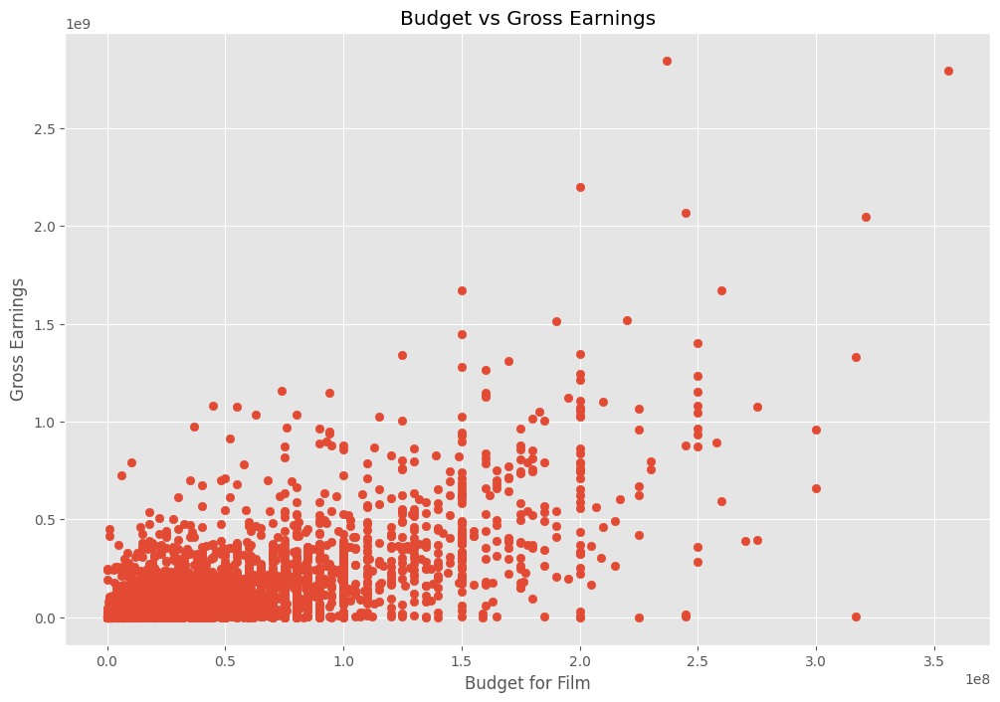

In [34]:
# build a scatter plot

plt.scatter(x=df['budget'], y=df['gross'])
plt.title('Budget vs Gross Earnings')
plt.xlabel('Budget for Film')
plt.ylabel('Gross Earnings')
plt.show()

<Axes: xlabel='budget', ylabel='gross'>

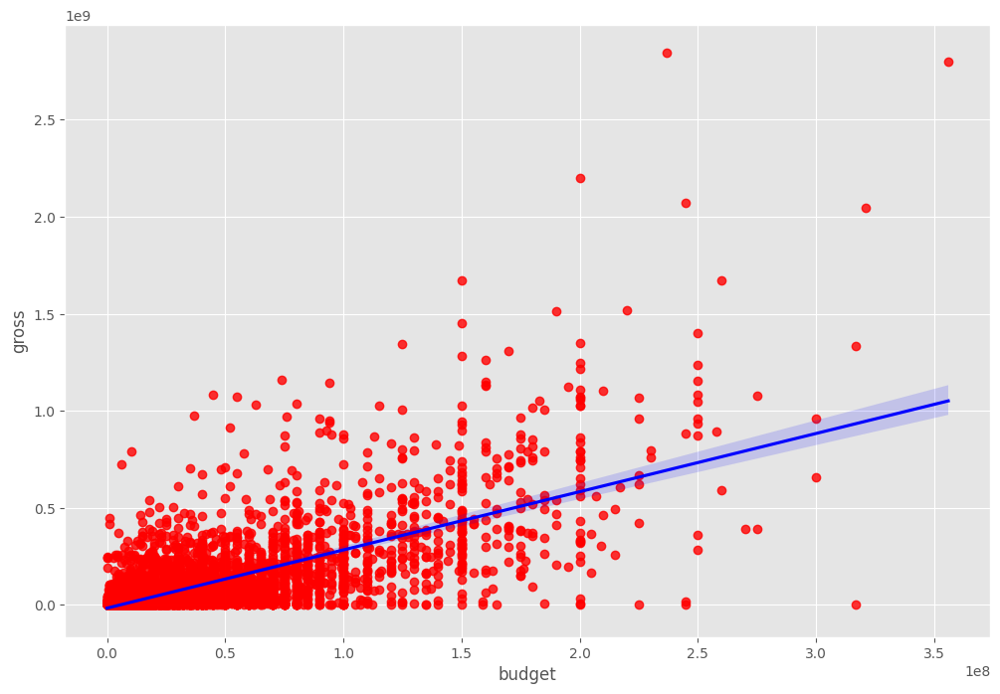

In [36]:
sns.regplot(x='budget', y='gross', data = df, scatter_kws = {'color':'red'}, line_kws = {'color':'blue'})

In [44]:
# pearson(by default), kendall, spearman
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns
correlation_matrix = df[numeric_columns].corr()
print(correlation_matrix)

             year     score     votes    budget     gross   runtime
year     1.000000  0.098098  0.222427  0.334314  0.261550  0.120694
score    0.098098  1.000000  0.409064  0.080708  0.186264  0.399116
votes    0.222427  0.409064  1.000000  0.449422  0.632341  0.309140
budget   0.334314  0.080708  0.449422  1.000000  0.701819  0.263424
gross    0.261550  0.186264  0.632341  0.701819  1.000000  0.245443
runtime  0.120694  0.399116  0.309140  0.263424  0.245443  1.000000


In [45]:
# we predicted high correlation between budget and gross and we were right

<function matplotlib.pyplot.show(close=None, block=None)>

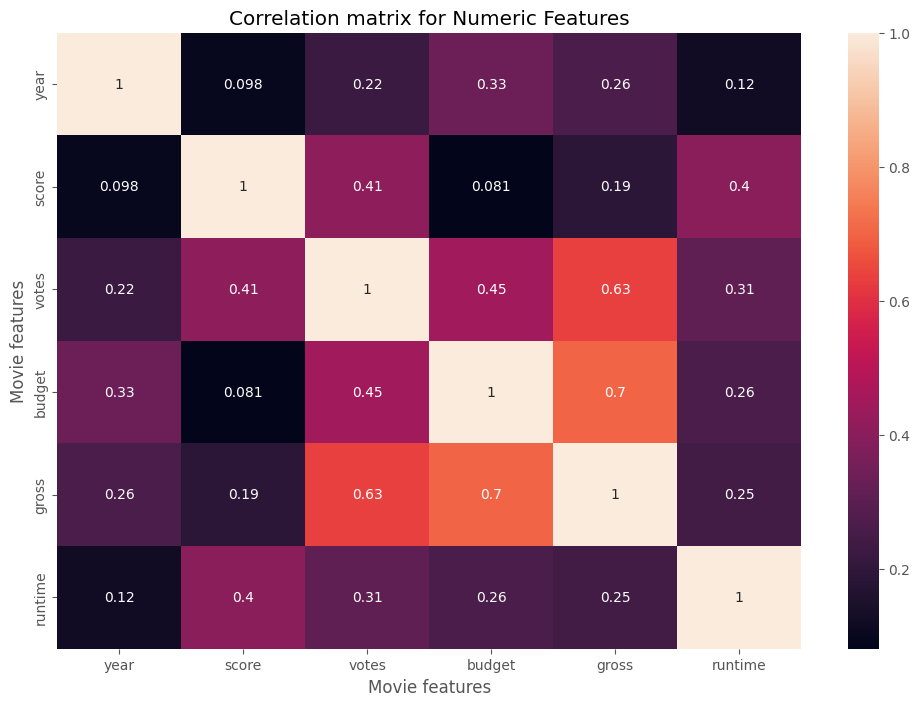

In [47]:
#making a heatmap to visualize correlation
sns.heatmap(correlation_matrix, annot = True)
plt.title("Correlation matrix for Numeric Features")
plt.xlabel("Movie features")
plt.ylabel("Movie features")
plt.show

In [48]:
df_numerized = df


for col_name in df_numerized.columns:
    if(df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name]= df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes
        
df_numerized

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,released_year
0,6587,6,6,1980,16,8.4,927000.0,2589,4014,1047,54,19000000,46998772,2319,146.0,0
1,5573,6,1,1980,20,5.8,65000.0,2269,1632,327,55,4500000,58853106,731,104.0,0
2,5142,4,0,1980,17,8.7,1200000.0,1111,2567,1745,55,18000000,538375067,1540,124.0,0
3,286,4,4,1980,20,7.7,221000.0,1301,2000,2246,55,3500000,83453539,1812,88.0,0
4,1027,6,4,1980,24,7.3,108000.0,1054,521,410,55,6000000,39846344,1777,98.0,0
5,2109,6,10,1980,10,6.4,123000.0,2528,4362,241,55,550000,39754601,1812,95.0,0
6,5574,6,0,1980,17,7.9,188000.0,1412,838,1277,55,27000000,115229890,2281,133.0,0
7,4436,6,3,1980,40,8.2,330000.0,1829,1769,2240,55,18000000,23402427,631,129.0,0
8,5281,4,0,1980,65,6.8,101000.0,2306,1979,877,55,54000000,108185706,883,127.0,1
9,6213,6,3,1980,11,7.0,10000.0,2864,423,589,55,10000000,15795189,2272,100.0,0


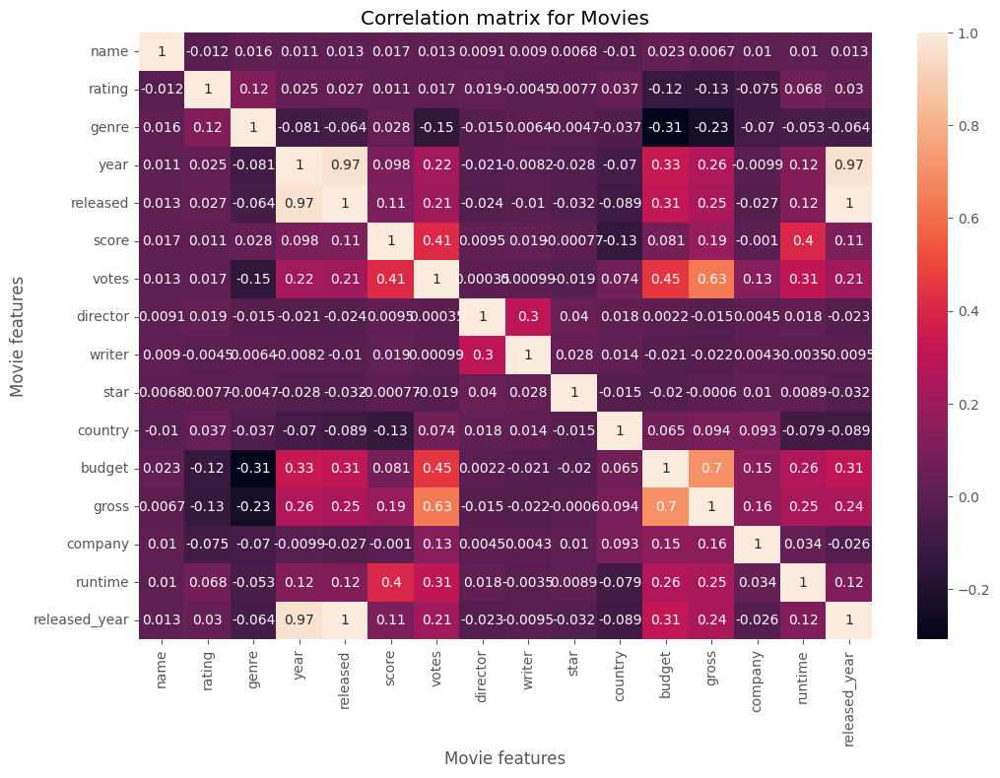

In [49]:
correlation_matrix1 = df_numerized.corr(method='pearson')

sns.heatmap(correlation_matrix1, annot = True)

plt.title("Correlation matrix for Movies")

plt.xlabel("Movie features")

plt.ylabel("Movie features")

plt.show()

In [50]:
df_numerized.corr()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,released_year
name,1.000000,-0.011776,0.016355,0.011453,0.013335,0.017237,0.013038,0.009079,0.009033,0.006820,-0.010127,0.022882,0.006747,0.009980,0.010448,0.012603
rating,-0.011776,1.000000,0.116837,0.025051,0.027485,0.011389,0.016909,0.018842,-0.004470,0.007728,0.036900,-0.117510,-0.126848,-0.075280,0.068470,0.029516
genre,0.016355,0.116837,1.000000,-0.081261,-0.063507,0.027832,-0.145296,-0.015258,0.006434,-0.004696,-0.036506,-0.308228,-0.232776,-0.070347,-0.052806,-0.063767
year,0.011453,0.025051,-0.081261,1.000000,0.968113,0.098098,0.222427,-0.020795,-0.008240,-0.027871,-0.069859,0.334314,0.261550,-0.009918,0.120694,0.967588
released,0.013335,0.027485,-0.063507,0.968113,1.000000,0.108771,0.205825,-0.023519,-0.010426,-0.031565,-0.089180,0.313648,0.245660,-0.026907,0.117818,0.999219
score,0.017237,0.011389,0.027832,0.098098,0.108771,1.000000,0.409064,0.009509,0.019214,-0.000772,-0.134361,0.080708,0.186264,-0.001013,0.399116,0.107532
votes,0.013038,0.016909,-0.145296,0.222427,0.205825,0.409064,1.000000,0.000349,0.000993,-0.019364,0.073612,0.449422,0.632341,0.132588,0.309140,0.206040
director,0.009079,0.018842,-0.015258,-0.020795,-0.023519,0.009509,0.000349,1.000000,0.299463,0.039834,0.017683,0.002167,-0.014536,0.004536,0.017537,-0.022573
writer,0.009033,-0.004470,0.006434,-0.008240,-0.010426,0.019214,0.000993,0.299463,1.000000,0.027740,0.014480,-0.020821,-0.022491,0.004274,-0.003506,-0.009533
star,0.006820,0.007728,-0.004696,-0.027871,-0.031565,-0.000772,-0.019364,0.039834,0.027740,1.000000,-0.014519,-0.019806,-0.000601,0.010243,0.008921,-0.031825


In [51]:
correlation_mat = df_numerized.corr()
corr_pairs = correlation_mat.unstack()
corr_pairs

name           name             1.000000
               rating          -0.011776
               genre            0.016355
               year             0.011453
               released         0.013335
               score            0.017237
               votes            0.013038
               director         0.009079
               writer           0.009033
               star             0.006820
               country         -0.010127
               budget           0.022882
               gross            0.006747
               company          0.009980
               runtime          0.010448
               released_year    0.012603
rating         name            -0.011776
               rating           1.000000
               genre            0.116837
               year             0.025051
               released         0.027485
               score            0.011389
               votes            0.016909
               director         0.018842
               w

In [52]:
sorted_pairs = corr_pairs.sort_values()
sorted_pairs

genre          budget          -0.308228
budget         genre           -0.308228
genre          gross           -0.232776
gross          genre           -0.232776
votes          genre           -0.145296
genre          votes           -0.145296
score          country         -0.134361
country        score           -0.134361
gross          rating          -0.126848
rating         gross           -0.126848
               budget          -0.117510
budget         rating          -0.117510
country        released        -0.089180
released       country         -0.089180
country        released_year   -0.089162
released_year  country         -0.089162
year           genre           -0.081261
genre          year            -0.081261
country        runtime         -0.078803
runtime        country         -0.078803
company        rating          -0.075280
rating         company         -0.075280
genre          company         -0.070347
company        genre           -0.070347
year           c

In [53]:
high_corr = sorted_pairs[(sorted_pairs) > 0.5]
high_corr

votes          gross            0.632341
gross          votes            0.632341
budget         gross            0.701819
gross          budget           0.701819
year           released_year    0.967588
released_year  year             0.967588
year           released         0.968113
released       year             0.968113
released_year  released         0.999219
released       released_year    0.999219
name           name             1.000000
company        company          1.000000
gross          gross            1.000000
budget         budget           1.000000
country        country          1.000000
star           star             1.000000
writer         writer           1.000000
director       director         1.000000
votes          votes            1.000000
score          score            1.000000
released       released         1.000000
year           year             1.000000
genre          genre            1.000000
rating         rating           1.000000
runtime        r

In [ ]:
# votes and budget has the highest correlation with gross